# Style-Transfer and Texture Synthesis

In this project, the goal is to reimplement certain aspects of two papers for style transfer and texture synthesis.

# Image Style Transfer Using Convolutional Neural Networks [1]

The goal of the approach described in [1] is to transfer the style of a style image $\vec{a}$ to a content image $\vec{p}$ by gradually applying changes to a target image $\vec{x}$ that is initially showing white noise (or for performance reasons the content image $\vec{p}$) such that $\vec{x}$ converges to an image that shows the content of $\vec{p}$ (e.g. KAUST) in the style of $\vec{a}$ (similar colors, brush strokes etc.) (cf. figure below) Details about the method are provided in Appendix A.

<center><img src='img/overview.jpg' width=80% /></center>

## Library imports and definition of some helper functions (do not change anything)

In [1]:
# import all needed resources
%matplotlib inline

from PIL import Image
from io import BytesIO
import matplotlib.pyplot as plt
import numpy as np
import time

import torch
import torch.nn as nn
import torch.optim as optim
import requests
from torchvision import transforms, models

In [2]:
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [3]:
if torch.cuda.is_available():
    print("Training on GPU")
else:
    print("Training on CPU")

Training on GPU


In [4]:
def load_image(img_path, max_size = 400, shape = None):
    
    ''' Load and downscale an image if the shorter side is longer than <max_size> px '''
    
    if "http" in img_path:
        response = requests.get(img_path)
        image = Image.open(BytesIO(response.content)).convert('RGB')
    else:
        image = Image.open(img_path).convert('RGB')
    
    if min(image.size) > max_size:
        size = max_size
    else:
        size = min(image.size)
    
    if shape is not None:
        size = shape
    
    in_transform = transforms.Compose([
                        transforms.Resize(size),
                        transforms.ToTensor(),
                        transforms.Normalize((0.485, 0.456, 0.406), 
                                             (0.229, 0.224, 0.225))])

    # discard alpha channel (:3) and append the batch dimension (unsqueeze(0))
    image = in_transform(image)[:3,:,:].unsqueeze(0)
    
    return image

In [5]:
# helper function for un-normalizing an image 
# and converting it from a Tensor image to a NumPy image for display
def im_convert(tensor):
    """ Convert a PyTorch tensor to a NumPy image. """
    
    image = tensor.to("cpu").clone().detach()
    image = image.numpy().squeeze()
    image = image.transpose(1,2,0)
    image = image * np.array((0.229, 0.224, 0.225)) + np.array((0.485, 0.456, 0.406))
    image = image.clip(0, 1)

    return image

In [6]:
''' Define and load corresponding content/style pairs '''

content_files = ['kaust', 'tesla', 'hamilton', 'mandela']
style_files = ['starry_night', 'jesuiten', 'scream', 'ben_passmore']
ref_vgg_files = ['vgg0_ref', 'vgg1_ref', 'vgg2_ref', 'vgg3_ref']
ref_resnet_files = ['res0_ref', 'res1_ref', 'res2_ref', 'res3_ref']

# load in content and style images
content = [load_image('img/content/' + c + '.jpg').to(device) for c in content_files]

# Resize style images to match corresponding content, makes code easier
style = [load_image('img/style/' + s + '.jpg', shape=content[n].shape[-2:]).to(device) for n, s in enumerate(style_files)]

ref_vgg =  [load_image('img/ref/' + c + '.jpg').to(device) for c in ref_vgg_files]
ref_res =  [load_image('img/ref/' + c + '.jpg').to(device) for c in ref_resnet_files]

# Create Target image and prepare it for change (requires_grad_(True))
# Starting with the content image and applying the style is usually faster than starting from a random image

# Target Image = Content Image
target = [c.clone().requires_grad_(True).to(device) for c in content]

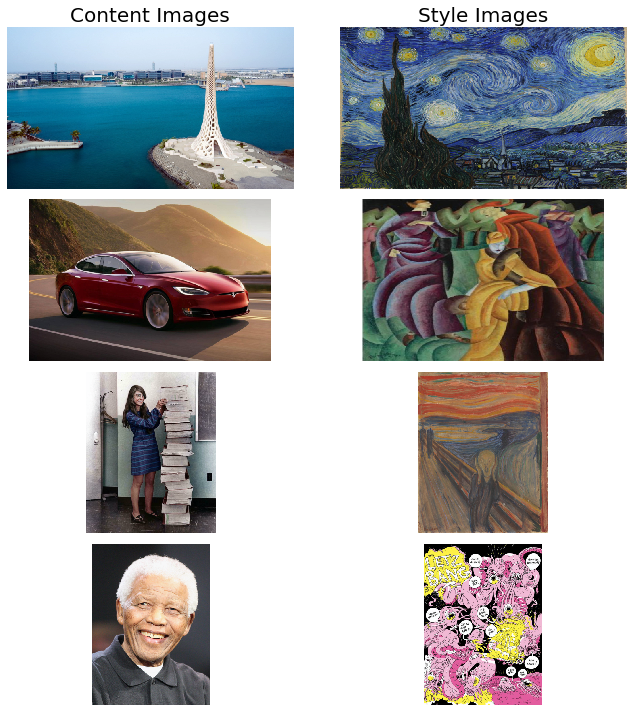

In [7]:
# display the images
num_pairs = len(content)
fig, axs = plt.subplots(num_pairs, 2, figsize=(10, 10))

axs[0, 0].set_title('Content Images', fontsize=20)
axs[0, 1].set_title('Style Images', fontsize=20)
#axs[0, 2].set_title('Target Images', fontsize=20)

# content and correspoinding style image side-by-side
for row in range(0, num_pairs):
        axs[row, 0].imshow(im_convert(content[row]))
        axs[row, 1].imshow(im_convert(style[row]))
        # axs[row, 2].imshow(im_convert(target[row]))

        for col in range(0, 2):
            axs[row, col].axis('off')
        
fig.tight_layout()
plt.show()

In [8]:
def get_features(image, model, layers):
    # Run an image forward through a model and get the features for a set of layers.
        
    features = {}
    x = image
    # model._modules is a dictionary holding each module in the model
    for name, layer in model._modules.items():
        x = layer(x)
        if name in layers:
            features[layers[name]] = x
            # features[name] = x
            
    return features

## Task 1: Calculate the $d \times d$ gram matrix corresponding to a $1 \times d \times h \times w$ tensor (10 points)

As described in [1], the style of an image can be represented by the Gram matrix of a layer consisting of a set of features maps.

In [9]:
import torch.nn.functional as F

In [10]:
def gram_matrix(tensor):
    """ Calculate the Gram Matrix of a given tensor 
        Gram Matrix: https://en.wikipedia.org/wiki/Gramian_matrix
    """
    
    # TODO Task 1: Implement the computation of the Gram Matrix
    
    ## get the batch_size, depth, height, and width of the Tensor
    ## reshape it, so we're multiplying the features for each channel
    ## calculate the gram matrix
    
    batch_size, depth, height, width = tensor.size()
    tensor_reshaped = tensor.view(batch_size * depth, height * width)
    tensor_normalized = F.normalize(tensor_reshaped, p = 2, dim = 1)
    
    gram = torch.mm(tensor_normalized, tensor_normalized.t())
    
    return gram

We normalize each feature map before calculating Gram matrix.

## Task 2: Complete the Training Function (15 points)

In order to complete this task, you might want to refer to the paper [1] and to the Appendix A. Note that the equations in Appendix A slightly differ from the originals in the paper. However, we highly recommend the equations in Appendix A since the equations in the paper seem to be inconsistent to the original implementation of the authors and are obviously missing normalization.

In [11]:
def run_model(model, layers, target, content_features, style_grams, content_layer, style_weights, content_weight = 1, style_weight = 1.0e12, steps = 5000, lr = 0.003):
    
    # for displaying the loss values, intermittently
    show_every = 500

    # iteration hyperparameters
    optimizer = optim.Adam([target], lr=lr)
    
    # Values of the learning curve
    learning_curve = np.zeros(steps)
    
#     print(learning_curve.shape)

    start = time.time()

    for ii in range(1, steps+1):
        
#         print("Target size:", target.size())

        
        ## TODO Task 2: get the features from the target image w.r.t. the provided model and the required layers
        target_features = get_features(target, model, layers)
        
#         print("Content layer features size:", target_features[content_layer].size())
#         print("Saved content layer size _must be equal to one above_:", content_features[content_layer].size())
        
        ## TODO Task 2: calculate the content loss (refer to Appendix A for details about the formula)
        content_loss = ((target_features[content_layer] - content_features[content_layer]) ** 2).mean(-1).mean(-1).mean(-1).squeeze(0)


        # the style loss
        # initialize the style loss to 0
        style_loss = 0
        
        # then add to it for each layer's gram matrix loss
        for layer in style_weights:

#             print("Layer: ", layer)
            
            target_feature = target_features[layer]
            
#             print("Corresponding feature map size:", target_feature.size())

            _, d, h, w = target_feature.shape

            
            ## TODO Task 2: Calculate the target gram matrix
            target_gram = gram_matrix(target_feature)
            
#             print("Corresponding Gram Matrix size:", target_gram.size())

            ## TODO Task 2: get the "style" style representation
            style_gram = style_grams[layer]
            
#             print("Saved Gram Matrix size _must be equal to one above_:", style_gram.size())

            ## TODO Task 2: Calculate the style loss for one layer, weighted appropriately (again, refer to Appendix A for details)
            layer_style_loss = style_weights[layer] * ((style_gram - target_gram) ** 2).sum()
            
#             print("(style_gram - target_gram) ** 2", (style_gram - target_gram) ** 2)
#             print("((style_gram - target_gram) ** 2).size() = ", ((style_gram - target_gram) ** 2).size())
#             print("(style_gram - target_gram) ** 2).sum() = ", ((style_gram - target_gram) ** 2).sum())
#             print("((style_gram - target_gram) ** 2).sum().size() = ", ((style_gram - target_gram) ** 2).sum().size())
#             print("Style_weights[layer]:", style_weights[layer])

#             print("Corresponding layer style loss size:", layer_style_loss.size())
            
            # add to the style loss
            style_loss += layer_style_loss

            
        # TODO Task 2: calculate the *total* loss
        total_loss = content_loss * content_weight + style_loss * style_weight
#         print("Content loss:", content_loss)
#         print("Content loss size:", content_loss.size())
#         print("Style loss:", style_loss)
#         print("Style loss size:", style_loss.size())
#         print("Total loss size:", total_loss.size())
    
        learning_curve[ii - 1] = total_loss

        # update your target image
        optimizer.zero_grad()
        total_loss.backward()
        optimizer.step()

        # display intermediate images and print the loss
        if  ii % show_every == 0:
            print('Total loss: ', total_loss.item())
            print('Weighted Content loss: ', content_weight * content_loss.item())
            print('Weighted Style loss: ', style_weight * style_loss.item())

            end = time.time()
            print('Time [s]: ', (end - start))
            plt.imshow(im_convert(target))
            plt.show()

    end = time.time()
    print('Total Time [s]: ', (end - start))
    
    return [target, learning_curve]

## VGG Network
We want to use the VGG-19 network for feature extraction first, since it was also suggestend by the authors of [1].

In [12]:
# get the "features" portion of VGG19 (we will not need the "classifier" portion)
vgg = models.vgg19(pretrained=True).features.to(device)

# freeze all VGG parameters since we're only optimizing the target image
for param in vgg.parameters():
    param.requires_grad_(False)

In [13]:
# print out VGG19 structure so you can see the numbers of various layers
print(vgg)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

## Task 3: Complete the mapping from VGG layer numbers to layer names (6 points)

Refer to the paper [1] to identify the layers that are suitable for content and style representation and complete the dictionary below that maps from layer numbers to layer names.
You may also want to print the VGG network using the print command above to see the layer numbers together with the corresponding layers.

In [14]:
## TODO Task 3: Complete mapping layer names of PyTorch's VGGNet to names from the paper
## Need the layers for the content and style representations of an image

# definition of all the layers needed from VGG net
layers_vgg = {'0': 'conv1_1',
             '5' : 'conv2_1',
             '10' : 'conv3_1',
             '19' : 'conv4_1',
             '21' : 'conv4_2',
             '28' : 'conv5_1'}

In [15]:
# get content and style features only once before training
content_features_vgg = [get_features(c, vgg, layers_vgg) for c in content]
style_features_vgg = [get_features(s, vgg, layers_vgg) for s in style]

# calculate the gram matrices for each layer of our style representation
#style_grams = {layer: gram_matrix(style_features[layer]) for layer in style_features}
style_grams_vgg = [{layer: gram_matrix(s[layer]) for layer in s} for s in style_features_vgg]

In [16]:
# Weights for VGG net
# weights for each style layer 
# weighting earlier layers more will result in *larger* style artifacts
# notice we are excluding `conv4_2` which is used for content representation

style_weights_vgg = {'conv1_1': 1.,
                     'conv2_1': 0.8,
                     'conv3_1': 0.5,
                     'conv4_1': 0.3,
                     'conv5_1': 0.1}

## Task 4: Styler Transfer using the VGG network (12 points - 4 examples, 3 points each)

Experiment with different weights for style (1.0e3, 1.0e6, 1.0e9, 1.0e12), different numbers of steps (e.g. 500, 1000, 2000) and different learning rates (e.g. 0.1, 0.01, 0.001) to find a set of parameters with which you can create a stylized image that looks similar to the provided reference solution as fast / efficient as possible. Plot the learning curve and put both the learning curvevs and training times together with the final result to your final report.

Total loss:  36912316284928.0
Weighted Content loss:  7.814047336578369
Weighted Style loss:  36912315368652.34
Time [s]:  25.98758578300476


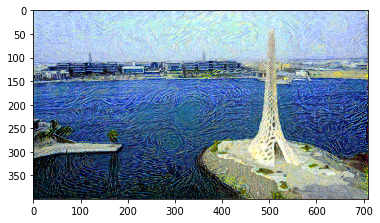

Total loss:  33453399605248.0
Weighted Content loss:  7.683244705200195
Weighted Style loss:  33453399658203.125
Time [s]:  52.33344388008118


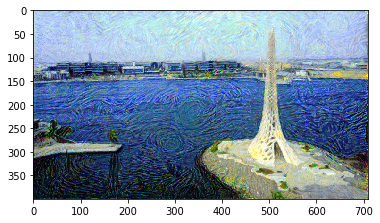

Total loss:  31334286229504.0
Weighted Content loss:  7.5994062423706055
Weighted Style loss:  31334285736083.984
Time [s]:  79.07967901229858


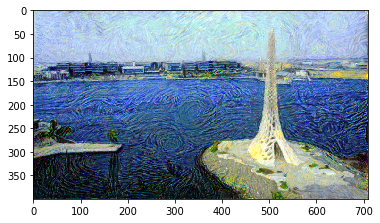

Total loss:  29950629380096.0
Weighted Content loss:  7.539251327514648
Weighted Style loss:  29950630187988.28
Time [s]:  106.18983793258667


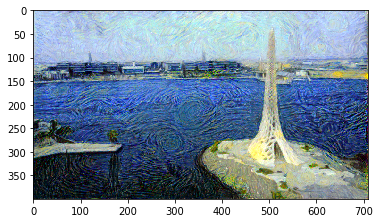

Total loss:  28882979782656.0
Weighted Content loss:  7.491015911102295
Weighted Style loss:  28882980346679.688
Time [s]:  133.18105578422546


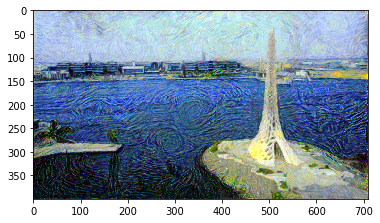

Total loss:  28095255937024.0
Weighted Content loss:  7.453733444213867
Weighted Style loss:  28095256805419.92
Time [s]:  161.0223650932312


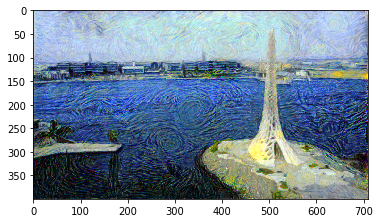

Total loss:  27347721912320.0
Weighted Content loss:  7.422791481018066
Weighted Style loss:  27347721099853.516
Time [s]:  188.16797494888306


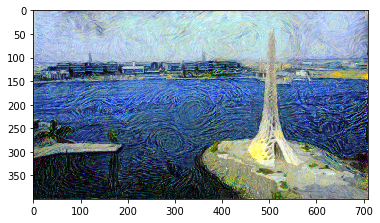

Total loss:  26736223846400.0
Weighted Content loss:  7.3983540534973145
Weighted Style loss:  26736223220825.195
Time [s]:  215.8961000442505


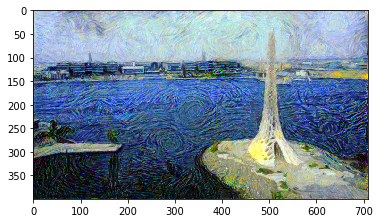

Total loss:  26174346493952.0
Weighted Content loss:  7.376019477844238
Weighted Style loss:  26174346923828.125
Time [s]:  242.86296224594116


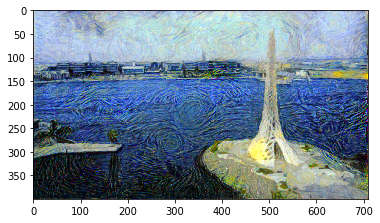

Total loss:  25672923742208.0
Weighted Content loss:  7.356029987335205
Weighted Style loss:  25672924041748.047
Time [s]:  270.4922115802765


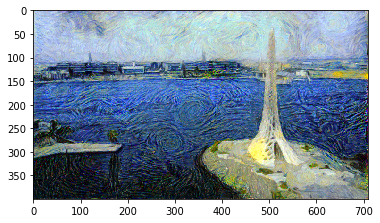

Total loss:  25250792210432.0
Weighted Content loss:  7.336899757385254
Weighted Style loss:  25250791549682.617
Time [s]:  297.4587948322296


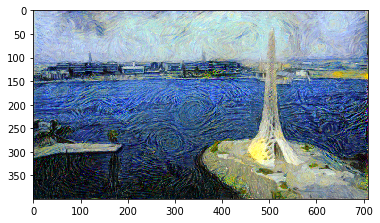

Total loss:  24849636392960.0
Weighted Content loss:  7.320733070373535
Weighted Style loss:  24849636077880.86
Time [s]:  325.1072151660919


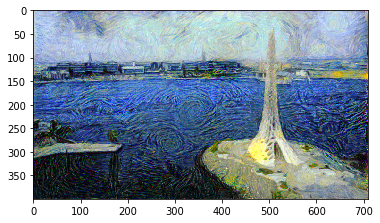

Total loss:  24511787302912.0
Weighted Content loss:  7.3040924072265625
Weighted Style loss:  24511787414550.78
Time [s]:  352.3128581047058


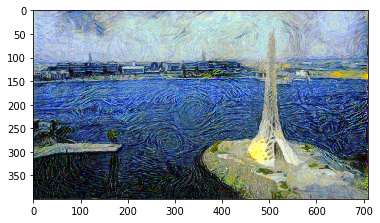

Total loss:  24158157144064.0
Weighted Content loss:  7.286316871643066
Weighted Style loss:  24158157348632.812
Time [s]:  379.6788423061371


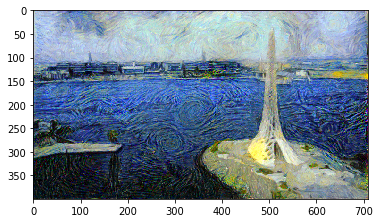

Total loss:  23821906083840.0
Weighted Content loss:  7.271974563598633
Weighted Style loss:  23821907043457.03
Time [s]:  406.92077255249023


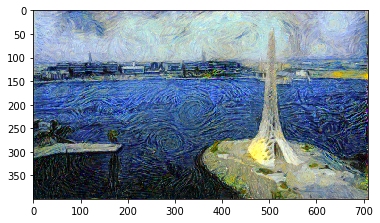

Total loss:  23520681656320.0
Weighted Content loss:  7.260478973388672
Weighted Style loss:  23520681381225.586
Time [s]:  434.28427481651306


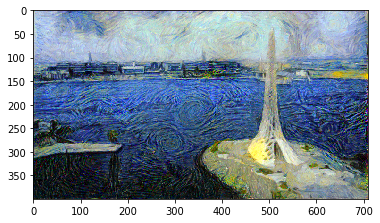

Total loss:  23372043911168.0
Weighted Content loss:  7.247042179107666
Weighted Style loss:  23372043609619.14
Time [s]:  461.5964388847351


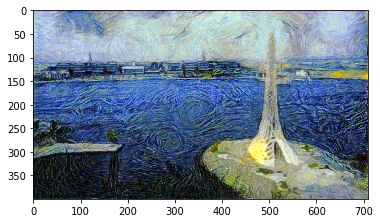

Total loss:  23219364954112.0
Weighted Content loss:  7.2333664894104
Weighted Style loss:  23219364166259.766
Time [s]:  488.71246814727783


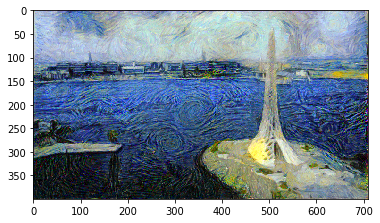

Total loss:  22887218020352.0
Weighted Content loss:  7.22249698638916
Weighted Style loss:  22887218475341.797
Time [s]:  515.7413249015808


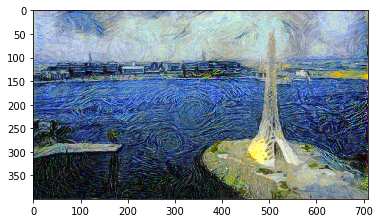

Total loss:  22661864357888.0
Weighted Content loss:  7.211618423461914
Weighted Style loss:  22661865234375.0
Time [s]:  543.206200838089


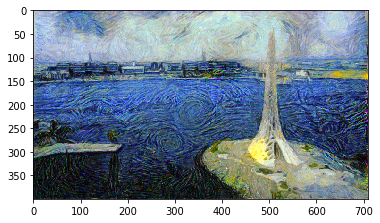

Total loss:  22435531325440.0
Weighted Content loss:  7.198310852050781
Weighted Style loss:  22435531616210.938
Time [s]:  570.9047794342041


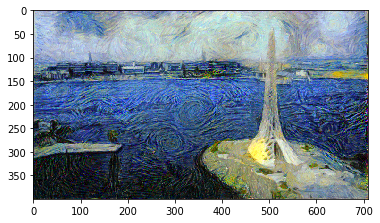

Total loss:  22255501312000.0
Weighted Content loss:  7.187617778778076
Weighted Style loss:  22255500793457.03
Time [s]:  597.8539588451385


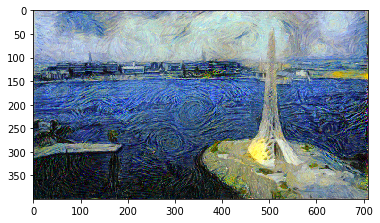

Total loss:  22073955057664.0
Weighted Content loss:  7.1770453453063965
Weighted Style loss:  22073955535888.67
Time [s]:  625.0271332263947


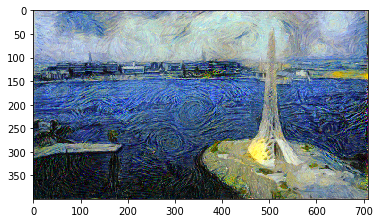

Total loss:  21900182945792.0
Weighted Content loss:  7.168882846832275
Weighted Style loss:  21900182723999.023
Time [s]:  652.2712104320526


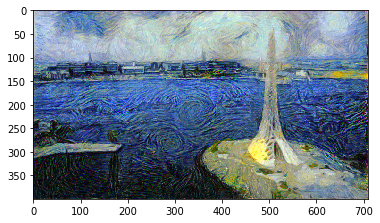

Total loss:  21728797392896.0
Weighted Content loss:  7.161638259887695
Weighted Style loss:  21728797912597.656
Time [s]:  679.7546362876892


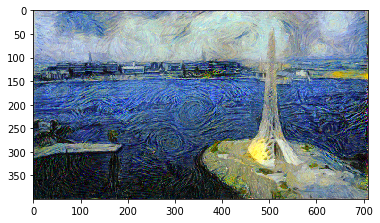

Total loss:  21598555865088.0
Weighted Content loss:  7.1508073806762695
Weighted Style loss:  21598556518554.688
Time [s]:  707.5700390338898


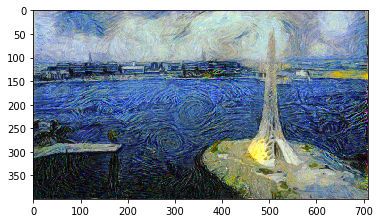

Total loss:  21419956109312.0
Weighted Content loss:  7.143460273742676
Weighted Style loss:  21419956207275.39
Time [s]:  735.0479803085327


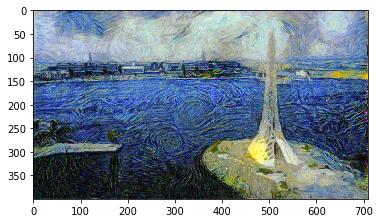

Total loss:  21275965652992.0
Weighted Content loss:  7.135430812835693
Weighted Style loss:  21275966644287.11
Time [s]:  762.5706670284271


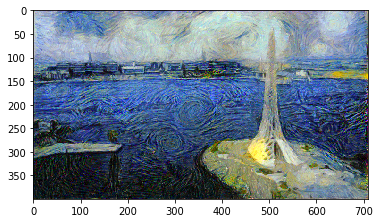

Total Time [s]:  762.7302441596985


In [27]:
# TODO Task 4: Style Transfer for content[0] and style[0] stored in target[0]
[s_0, slc_0] = run_model(vgg, layers_vgg, target[0], content_features_vgg[0], style_grams_vgg[0], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e12, steps = 14000, lr = 0.003)

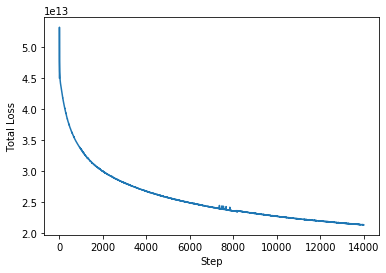

In [28]:
plt.plot(slc_0)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

Total loss:  54893226229760.0
Weighted Content loss:  8.250349044799805
Weighted Style loss:  54893226623535.16
Time [s]:  21.65071201324463


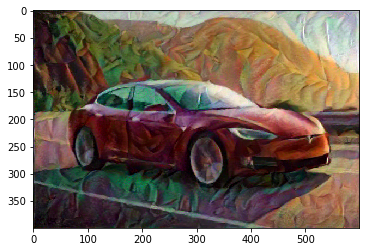

Total loss:  45678541668352.0
Weighted Content loss:  8.357536315917969
Weighted Style loss:  45678543090820.31
Time [s]:  43.739864110946655


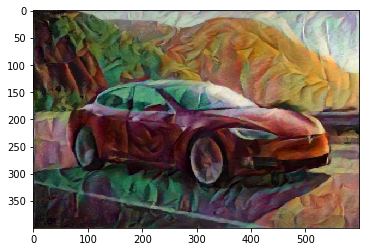

Total loss:  42413313753088.0
Weighted Content loss:  8.43838119506836
Weighted Style loss:  42413314819335.94
Time [s]:  65.96223378181458


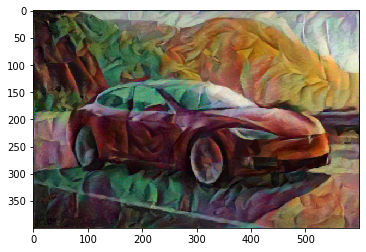

Total loss:  40046853881856.0
Weighted Content loss:  8.597707748413086
Weighted Style loss:  40046855926513.67
Time [s]:  88.49073123931885


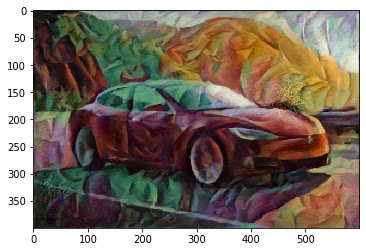

Total loss:  38034867224576.0
Weighted Content loss:  8.6089506149292
Weighted Style loss:  38034866333007.81
Time [s]:  112.0381510257721


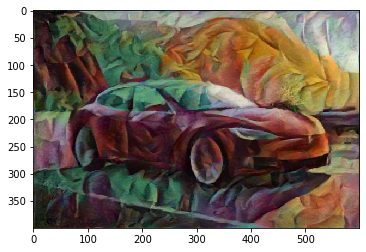

Total loss:  36927185092608.0
Weighted Content loss:  8.633439064025879
Weighted Style loss:  36927185058593.75
Time [s]:  134.5679268836975


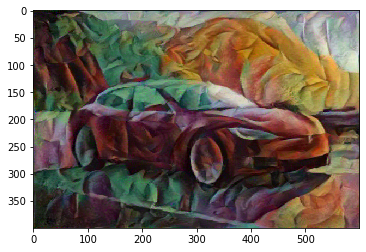

Total loss:  36032430997504.0
Weighted Content loss:  8.667835235595703
Weighted Style loss:  36032432556152.34
Time [s]:  157.71154141426086


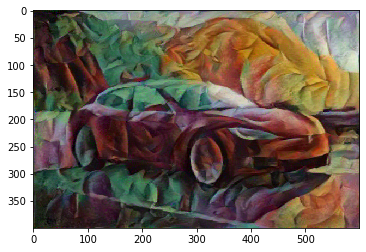

Total loss:  35357819142144.0
Weighted Content loss:  8.656717300415039
Weighted Style loss:  35357818603515.625
Time [s]:  180.35939383506775


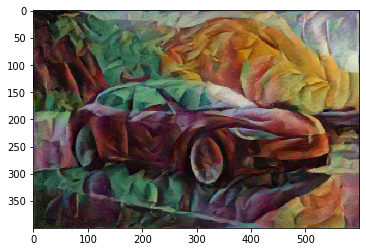

Total loss:  34837100494848.0
Weighted Content loss:  8.685213088989258
Weighted Style loss:  34837100982666.016
Time [s]:  203.59011507034302


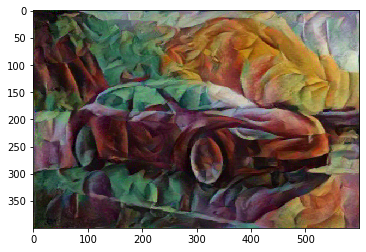

Total loss:  34697075752960.0
Weighted Content loss:  8.71590518951416
Weighted Style loss:  34697074890136.72
Time [s]:  227.02712321281433


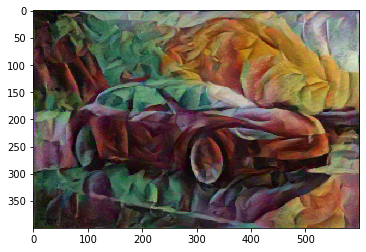

Total Time [s]:  227.19475889205933


In [29]:
# TODO Task 4: Style Transfer for content[1] and style[1] stored in target[1]
[s_1, slc_1] = run_model(vgg, layers_vgg, target[1], content_features_vgg[1], style_grams_vgg[1], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e12, steps = 5000, lr = 0.03)

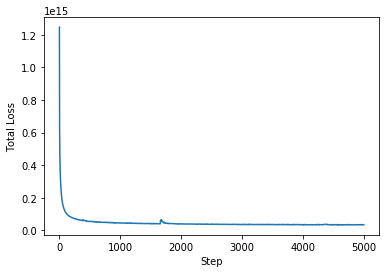

In [30]:
plt.plot(slc_1)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

Total loss:  88611928145920.0
Weighted Content loss:  9.969106674194336
Weighted Style loss:  88611930847167.97
Time [s]:  18.41666030883789


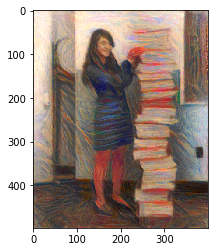

Total loss:  62366993612800.0
Weighted Content loss:  9.94831371307373
Weighted Style loss:  62366992950439.45
Time [s]:  37.121192932128906


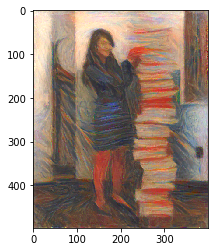

Total loss:  52260369334272.0
Weighted Content loss:  9.978299140930176
Weighted Style loss:  52260368347167.97
Time [s]:  55.93778681755066


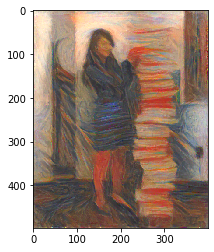

Total loss:  46797024133120.0
Weighted Content loss:  10.009699821472168
Weighted Style loss:  46797023773193.36
Time [s]:  74.93674635887146


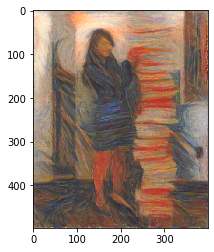

Total loss:  43806590238720.0
Weighted Content loss:  10.04366683959961
Weighted Style loss:  43806591033935.55
Time [s]:  94.8934428691864


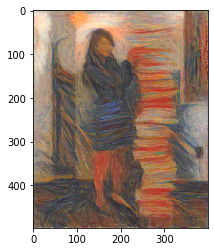

Total loss:  39656175435776.0
Weighted Content loss:  10.045904159545898
Weighted Style loss:  39656173706054.69
Time [s]:  114.3970718383789


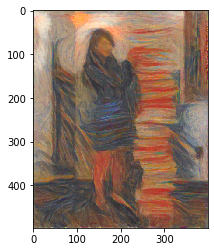

Total loss:  36821786427392.0
Weighted Content loss:  10.121086120605469
Weighted Style loss:  36821784973144.53
Time [s]:  134.3041741847992


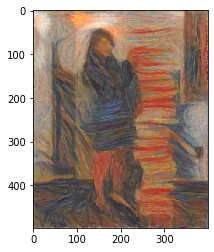

Total loss:  35309584646144.0
Weighted Content loss:  10.111528396606445
Weighted Style loss:  35309585571289.06
Time [s]:  153.87524509429932


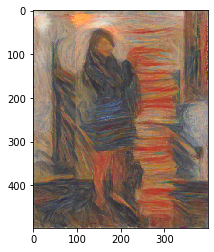

Total loss:  35256753192960.0
Weighted Content loss:  10.132234573364258
Weighted Style loss:  35256752014160.16
Time [s]:  173.7408583164215


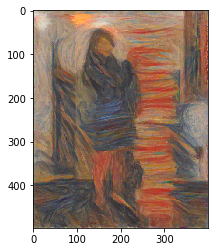

Total loss:  32320438403072.0
Weighted Content loss:  10.116353034973145
Weighted Style loss:  32320438385009.766
Time [s]:  193.74847054481506


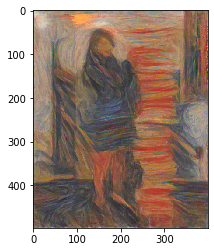

Total Time [s]:  193.86413264274597


In [31]:
# TODO Task 4: Style Transfer for content[2] and style[2] stored in target[2]
[s_2, slc_2] = run_model(vgg, layers_vgg, target[2], content_features_vgg[2], style_grams_vgg[2], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e12, steps = 5000, lr = 0.03)

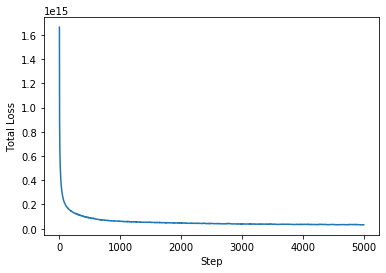

In [32]:
plt.plot(slc_2)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

Total loss:  63679580078080.0
Weighted Content loss:  14.517162322998047
Weighted Style loss:  63679580688476.56
Time [s]:  20.19699716567993


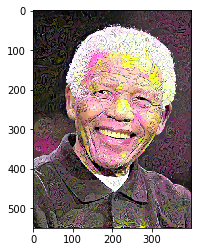

Total loss:  49097306275840.0
Weighted Content loss:  15.488431930541992
Weighted Style loss:  49097305297851.56
Time [s]:  40.71441626548767


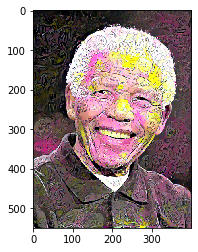

Total loss:  42630272516096.0
Weighted Content loss:  16.045175552368164
Weighted Style loss:  42630271911621.09
Time [s]:  61.90591907501221


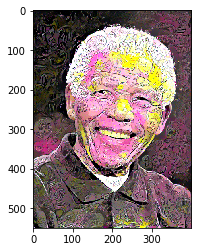

Total loss:  39718850920448.0
Weighted Content loss:  16.371517181396484
Weighted Style loss:  39718849182128.91
Time [s]:  84.02772045135498


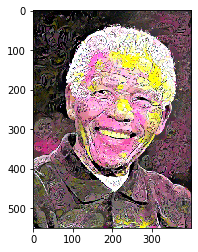

Total loss:  37597124493312.0
Weighted Content loss:  16.68954086303711
Weighted Style loss:  37597126007080.08
Time [s]:  105.44893503189087


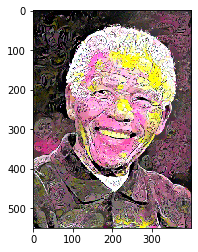

Total loss:  36232788705280.0
Weighted Content loss:  16.931034088134766
Weighted Style loss:  36232788085937.5
Time [s]:  126.77911639213562


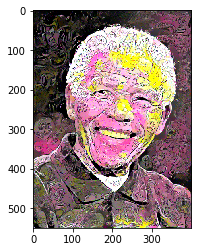

Total loss:  34991721414656.0
Weighted Content loss:  17.1175537109375
Weighted Style loss:  34991722106933.594
Time [s]:  148.63323855400085


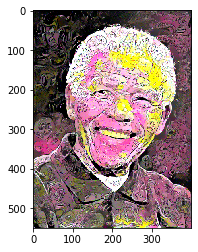

Total loss:  33891784065024.0
Weighted Content loss:  17.26799964904785
Weighted Style loss:  33891784667968.75
Time [s]:  169.92968797683716


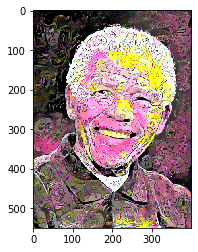

Total loss:  32764021702656.0
Weighted Content loss:  17.43231201171875
Weighted Style loss:  32764022827148.438
Time [s]:  192.20523691177368


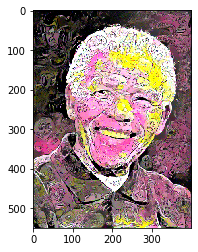

Total loss:  32140135759872.0
Weighted Content loss:  17.576549530029297
Weighted Style loss:  32140136718750.0
Time [s]:  213.8675799369812


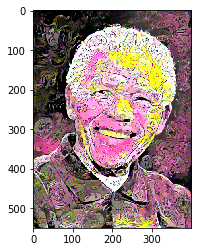

Total Time [s]:  214.00058674812317


In [33]:
# TODO Task 4: Style Transfer for content[3] and style[3] stored in target[3]
[s_3, slc_3] = run_model(vgg, layers_vgg, target[3], content_features_vgg[3], style_grams_vgg[3], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e12, steps = 5000, lr = 0.03)

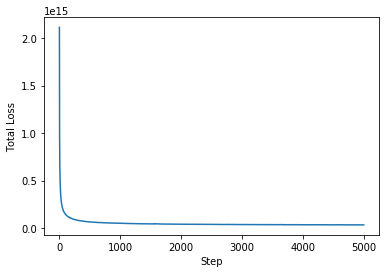

In [34]:
plt.plot(slc_3)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

In [17]:
def result_to_hd(image, filePath):
    image = im_convert(image)

    formatted = (image * 255 / np.max(image)).astype('uint8')
    pil_image = Image.fromarray(formatted, 'RGB')
    pil_image.save(filePath, "JPEG")

In [36]:
# Save results to hard disc
result_to_hd(s_0, "s0.jpg")
result_to_hd(s_1, "s1.jpg")
result_to_hd(s_2, "s2.jpg")
result_to_hd(s_3, "s3.jpg")

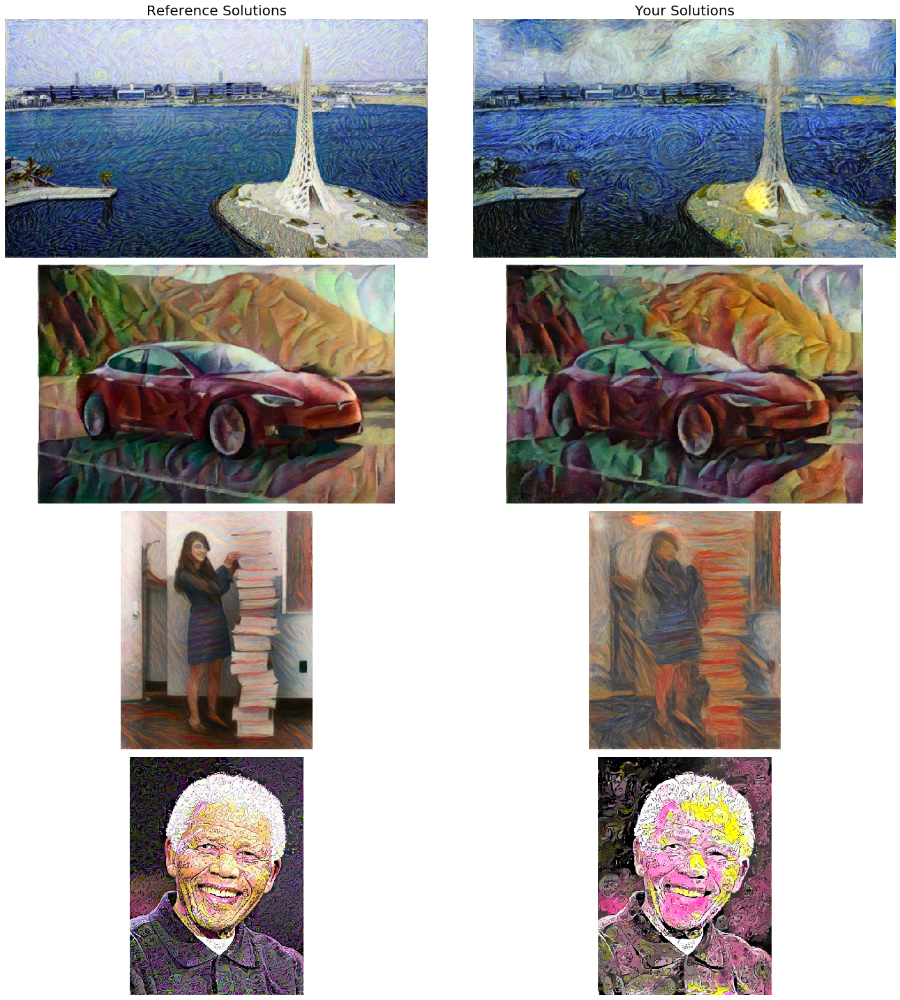

In [37]:
# Comparison to Reference Solution - Do not change anything, just execute to varify correctness of your solution

fig, axs = plt.subplots(num_pairs, 2, figsize=(20, 20))

axs[0, 0].set_title('Reference Solutions', fontsize=20)
axs[0, 1].set_title('Your Solutions', fontsize=20)

# content and correspoinding style image side-by-side
for row in range(0, num_pairs):
        axs[row, 0].imshow(im_convert(ref_vgg[row]))
        axs[row, 1].imshow(im_convert(target[row]))

        for col in range(0, 2):
            axs[row, col].axis('off')
        
fig.tight_layout()
plt.show()

## ResNet-18

Although the authors suggested to use the VGG net for feature extraction, we want to experiment with a different net in the next step and choose the ResNet-18 network for this purpose.

## Task 5: Apply changes to ResNet-18 (5 points) 

In [18]:
# get the resnet18 model
resnet = models.resnet18(pretrained=True).to(device)

In [19]:
print(resnet)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [20]:
# TODO Task 5: Remove last few layers (avgpool and fc) from resnet by substituting them with 'identity' (e.g. empty Sequential) layers
# since they are not needed and are also incompatible to the size of our input images

class Identity(nn.Module):
    def __init__(self):
        super(Identity, self).__init__()
        
    def forward(self, x):
        return x

resnet.avgpool = Identity()
resnet.fc = Identity()


# freeze all resnet parameters since we're only optimizing the target image
for param in resnet.parameters():
    param.requires_grad_(False)

In [21]:
# print out ResNet-18 structure so you can see the names of various layers
print(resnet)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [22]:
# definition of all the layers needed from resnet-18
layers_resnet = { 'conv1': 'conv1',
                 'layer1': 'conv2_x',
                 'layer2': 'conv3_x',
                 'layer3': 'conv4_x',
                 'layer4': 'conv5_x'}

In [23]:
# get content and style features only once before training
content_features_resnet = [get_features(c, resnet, layers_resnet) for c in content]
style_features_resnet = [get_features(s, resnet, layers_resnet) for s in style]

# calculate the gram matrices for each layer of our style representation
style_grams_resnet = [{layer: gram_matrix(s[layer]) for layer in s} for s in style_features_resnet]

In [24]:
# 'conv1': 1.,
style_weights_resnet = {'conv2_x': 0.8,
                        'conv3_x': 0.5,
                        'conv4_x': 0.3,
                        'conv5_x': 0.1}

## Task 6: Styler Transfer using ResNet-18 (12 points - 4 examples, 3 points each)

Experiment with different weights for style (1.0e3, 1.0e6, 1.0e9, 1.0e12), different numbers of steps (e.g. 2000, 5000, 10000) and different learning rates (e.g. 0.1, 0.01, 0.001) to find a set of parameters with which you can create a stylized image that looks similar (or preferably better) to the provided reference solution.

In [25]:
# Target Image = Content Image (Reload original images)
target = [c.clone().requires_grad_(True).to(device) for c in content]

Total loss:  65719207198720.0
Weighted Content loss:  0.05385579913854599
Weighted Style loss:  65719207763671.875
Time [s]:  5.6886842250823975


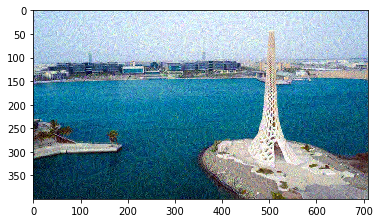

Total loss:  51402126655488.0
Weighted Content loss:  0.0549471378326416
Weighted Style loss:  51402126312255.86
Time [s]:  11.560408592224121


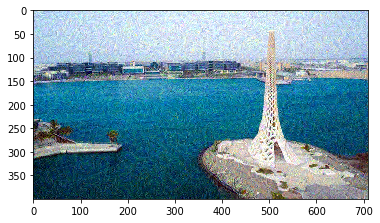

Total loss:  46717332357120.0
Weighted Content loss:  0.05535358563065529
Weighted Style loss:  46717330932617.19
Time [s]:  17.444117546081543


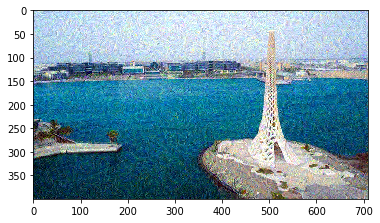

Total loss:  44160962789376.0
Weighted Content loss:  0.05553464591503143
Weighted Style loss:  44160964965820.31
Time [s]:  23.334132194519043


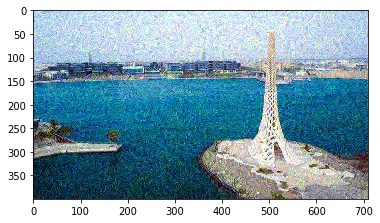

Total loss:  48366830485504.0
Weighted Content loss:  0.0557110495865345
Weighted Style loss:  48366828918457.03
Time [s]:  29.23855686187744


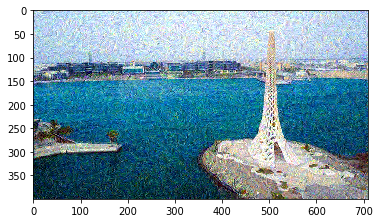

Total loss:  38721709670400.0
Weighted Content loss:  0.05592840537428856
Weighted Style loss:  38721710205078.125
Time [s]:  35.30148673057556


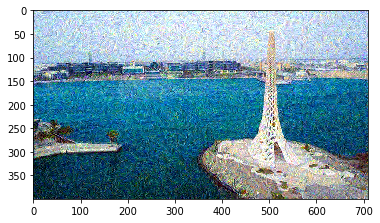

Total loss:  37687318806528.0
Weighted Content loss:  0.05601030960679054
Weighted Style loss:  37687316894531.25
Time [s]:  41.241342306137085


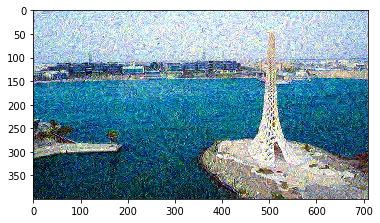

Total loss:  36546795274240.0
Weighted Content loss:  0.05609225481748581
Weighted Style loss:  36546794891357.42
Time [s]:  47.17819571495056


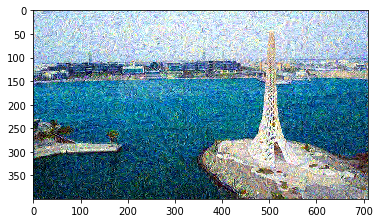

Total loss:  35590355550208.0
Weighted Content loss:  0.05613311380147934
Weighted Style loss:  35590354919433.59
Time [s]:  53.097663164138794


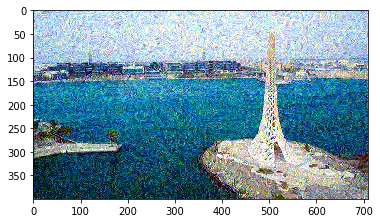

Total loss:  36770406203392.0
Weighted Content loss:  0.056176669895648956
Weighted Style loss:  36770404815673.83
Time [s]:  59.01822781562805


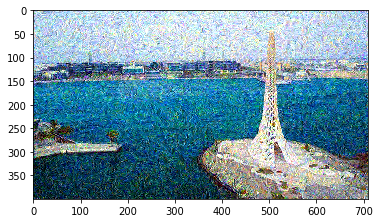

Total Time [s]:  59.205151081085205


In [32]:
# TODO Task 4: Style Transfer for content[0] and style[0] stored in target[0]
[res_0, reslc_0] = run_model(resnet, layers_resnet, target[0], content_features_resnet[0], style_grams_resnet[0], 'conv4_x', style_weights_resnet, content_weight = 1, style_weight = 1.0e12, steps = 5000, lr = 0.03)

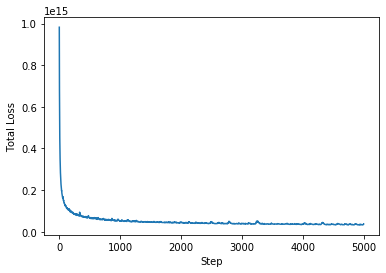

In [33]:
plt.plot(reslc_0)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

Total loss:  48776802729984.0
Weighted Content loss:  0.052683025598526
Weighted Style loss:  48776802062988.28
Time [s]:  5.381291627883911


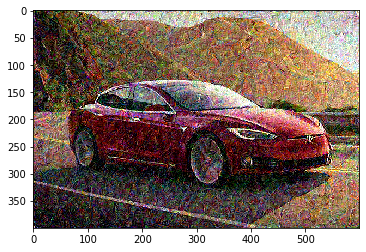

Total loss:  45418960388096.0
Weighted Content loss:  0.05286630988121033
Weighted Style loss:  45418960571289.06
Time [s]:  10.587501049041748


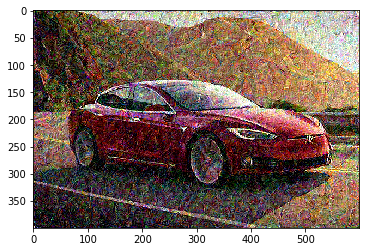

Total loss:  45433397182464.0
Weighted Content loss:  0.052823346108198166
Weighted Style loss:  45433395385742.19
Time [s]:  15.781362533569336


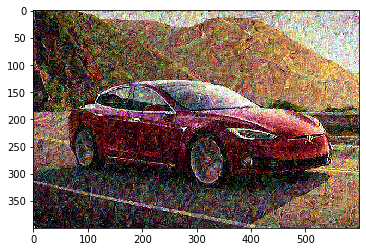

Total loss:  41840921280512.0
Weighted Content loss:  0.05294844135642052
Weighted Style loss:  41840919494628.91
Time [s]:  21.005004405975342


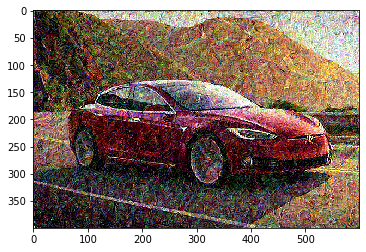

Total loss:  41257149661184.0
Weighted Content loss:  0.052958253771066666
Weighted Style loss:  41257148742675.78
Time [s]:  26.242203950881958


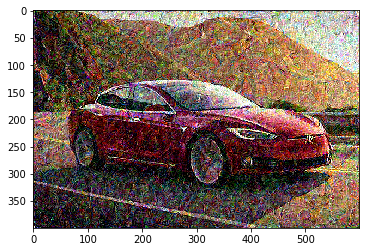

Total loss:  40722396872704.0
Weighted Content loss:  0.05301061272621155
Weighted Style loss:  40722396850585.94
Time [s]:  31.464426279067993


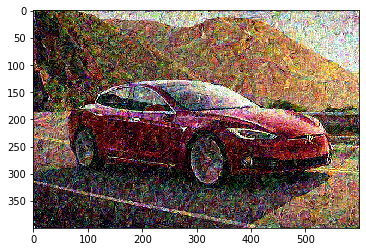

Total loss:  39678526881792.0
Weighted Content loss:  0.05305677652359009
Weighted Style loss:  39678527832031.25
Time [s]:  36.68796920776367


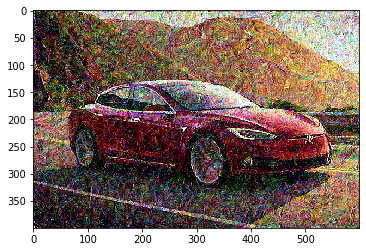

Total loss:  40317361324032.0
Weighted Content loss:  0.05310570448637009
Weighted Style loss:  40317359924316.41
Time [s]:  41.89744782447815


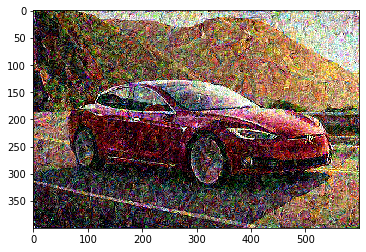

Total loss:  38530445213696.0
Weighted Content loss:  0.05314897745847702
Weighted Style loss:  38530445098876.95
Time [s]:  47.15661430358887


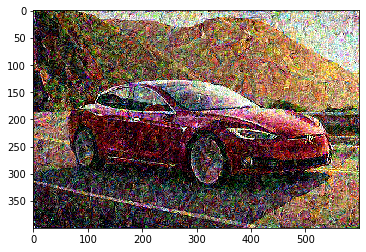

Total loss:  39001318752256.0
Weighted Content loss:  0.05317787453532219
Weighted Style loss:  39001319885253.91
Time [s]:  53.202805042266846


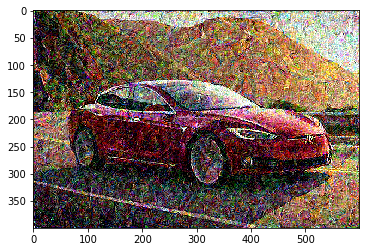

Total loss:  37619836649472.0
Weighted Content loss:  0.0531981959939003
Weighted Style loss:  37619838714599.61
Time [s]:  58.564284324645996


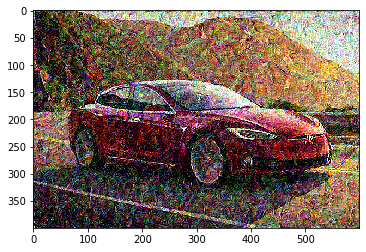

Total loss:  36692979351552.0
Weighted Content loss:  0.053206466138362885
Weighted Style loss:  36692977905273.44
Time [s]:  64.02205204963684


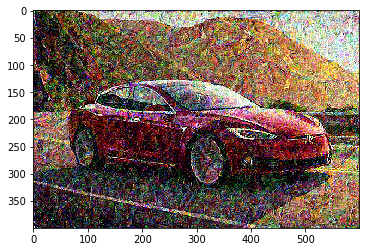

Total loss:  38699479859200.0
Weighted Content loss:  0.05322660878300667
Weighted Style loss:  38699478149414.06
Time [s]:  69.32349848747253


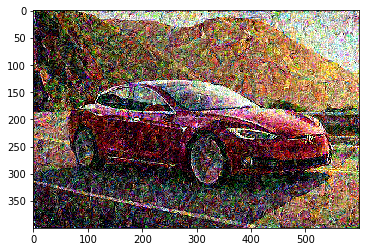

Total loss:  36247938531328.0
Weighted Content loss:  0.053218044340610504
Weighted Style loss:  36247940063476.56
Time [s]:  74.65314650535583


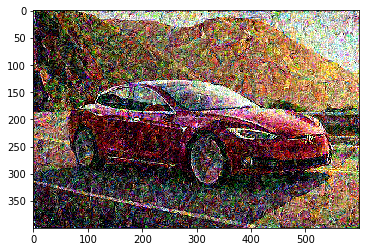

Total loss:  35988227227648.0
Weighted Content loss:  0.05325547605752945
Weighted Style loss:  35988227844238.28
Time [s]:  79.98927140235901


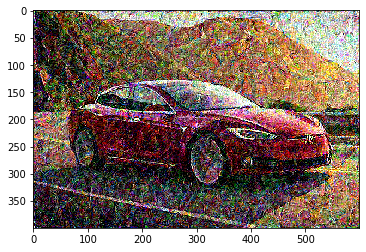

Total loss:  38301268443136.0
Weighted Content loss:  0.053350143134593964
Weighted Style loss:  38301269531250.0
Time [s]:  85.33194231987


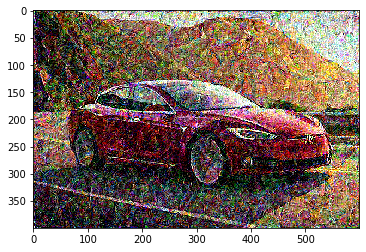

Total loss:  34912375668736.0
Weighted Content loss:  0.053305674344301224
Weighted Style loss:  34912376403808.594
Time [s]:  90.67756175994873


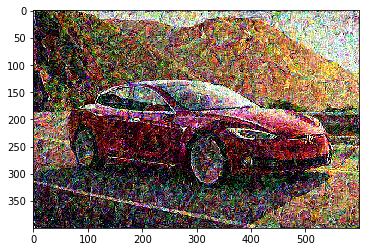

Total loss:  37294065057792.0
Weighted Content loss:  0.05334840342402458
Weighted Style loss:  37294063568115.234
Time [s]:  96.03804349899292


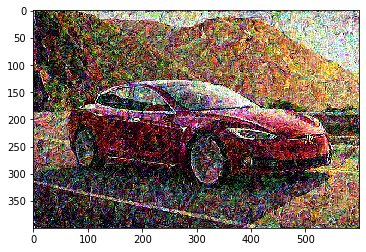

Total loss:  35258254753792.0
Weighted Content loss:  0.053343795239925385
Weighted Style loss:  35258255004882.81
Time [s]:  101.40977811813354


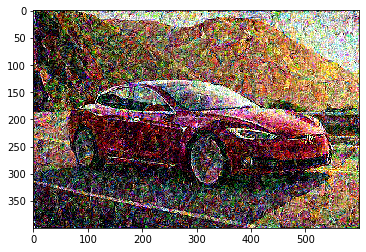

Total loss:  34676009861120.0
Weighted Content loss:  0.05336694419384003
Weighted Style loss:  34676010131835.938
Time [s]:  106.76897478103638


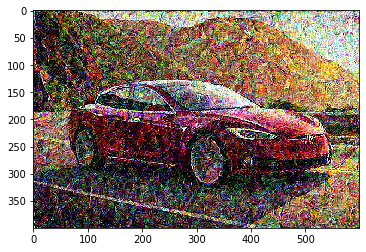

Total Time [s]:  106.93947625160217


In [35]:
# TODO Task 4: Style Transfer for content[1] and style[1] stored in target[1]
[res_1, reslc_1] = run_model(resnet, layers_resnet, target[1], content_features_resnet[1], style_grams_resnet[1], 'conv4_x', style_weights_resnet, content_weight = 1, style_weight = 1.0e12, steps = 10000, lr = 0.03)

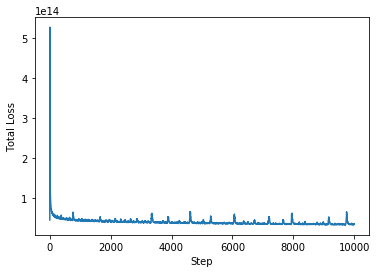

In [36]:
plt.plot(reslc_1)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

Total loss:  109755246837760.0
Weighted Content loss:  0.048709169030189514
Weighted Style loss:  109755249023437.5
Time [s]:  5.335747241973877


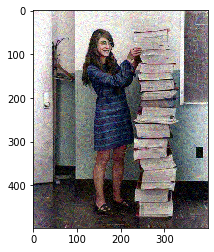

Total loss:  88090936868864.0
Weighted Content loss:  0.049958135932683945
Weighted Style loss:  88090934753417.97
Time [s]:  10.718001365661621


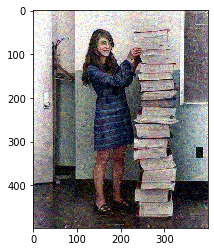

Total loss:  79676139634688.0
Weighted Content loss:  0.0505320280790329
Weighted Style loss:  79676139831542.97
Time [s]:  16.06668448448181


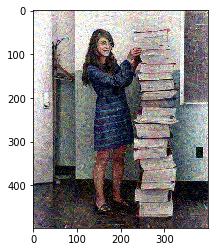

Total loss:  74479464087552.0
Weighted Content loss:  0.05112438648939133
Weighted Style loss:  74479461669921.88
Time [s]:  21.4278781414032


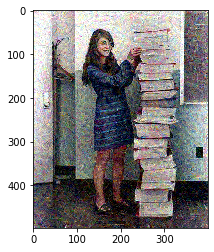

Total loss:  74227478691840.0
Weighted Content loss:  0.051417026668787
Weighted Style loss:  74227478027343.75
Time [s]:  26.34890055656433


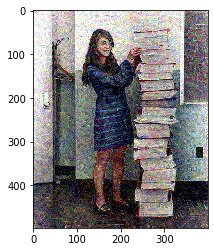

Total loss:  72003583213568.0
Weighted Content loss:  0.05155829340219498
Weighted Style loss:  72003585815429.69
Time [s]:  31.726792812347412


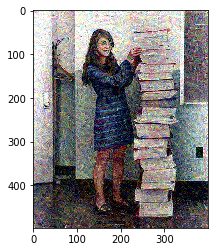

Total loss:  71715929456640.0
Weighted Content loss:  0.05175018310546875
Weighted Style loss:  71715927124023.44
Time [s]:  37.128822565078735


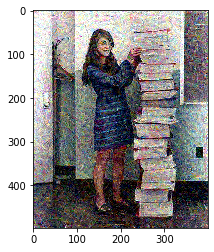

Total loss:  63927262117888.0
Weighted Content loss:  0.05191506817936897
Weighted Style loss:  63927261352539.06
Time [s]:  42.08262538909912


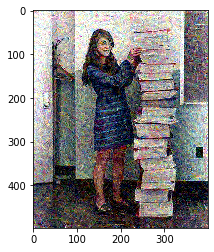

Total loss:  62568408285184.0
Weighted Content loss:  0.05202467739582062
Weighted Style loss:  62568408966064.45
Time [s]:  47.46899938583374


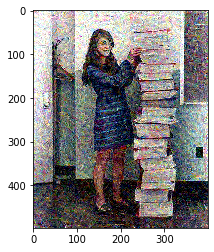

Total loss:  60700567273472.0
Weighted Content loss:  0.05208306014537811
Weighted Style loss:  60700569152832.03
Time [s]:  52.85323739051819


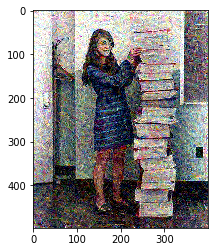

Total Time [s]:  52.98741579055786


In [37]:
# TODO Task 4: Style Transfer for content[2] and style[2] stored in target[2]
[res_2, reslc_2] = run_model(resnet, layers_resnet, target[2], content_features_resnet[2], style_grams_resnet[2], 'conv4_x', style_weights_resnet, content_weight = 1, style_weight = 1.0e12, steps = 5000, lr = 0.03)

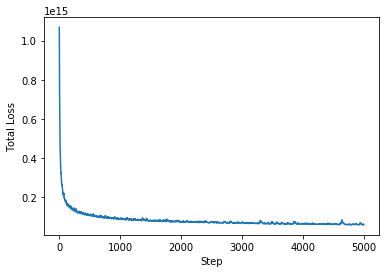

In [38]:
plt.plot(reslc_2)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

Total loss:  86216720515072.0
Weighted Content loss:  0.054413095116615295
Weighted Style loss:  86216720581054.69
Time [s]:  4.873584985733032


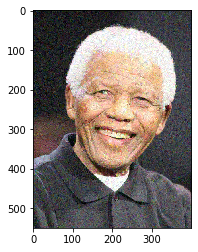

Total loss:  69021974134784.0
Weighted Content loss:  0.05515250936150551
Weighted Style loss:  69021972656250.0
Time [s]:  9.784674882888794


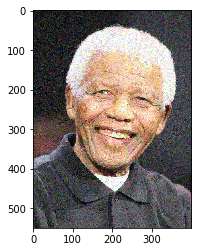

Total loss:  66711394975744.0
Weighted Content loss:  0.05551174283027649
Weighted Style loss:  66711395263671.875
Time [s]:  14.718313455581665


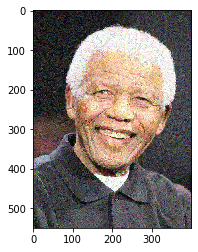

Total loss:  58843191050240.0
Weighted Content loss:  0.05576455965638161
Weighted Style loss:  58843189239501.95
Time [s]:  19.82349967956543


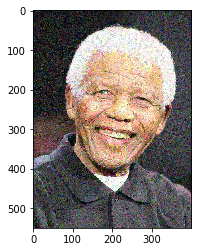

Total loss:  53492945256448.0
Weighted Content loss:  0.055939026176929474
Weighted Style loss:  53492946624755.86
Time [s]:  24.782284259796143


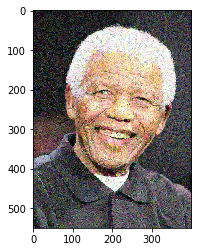

Total loss:  55770980810752.0
Weighted Content loss:  0.05603623390197754
Weighted Style loss:  55770980834960.94
Time [s]:  29.74526357650757


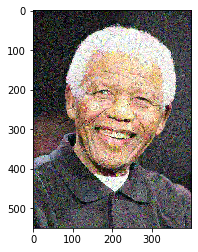

Total loss:  49288092581888.0
Weighted Content loss:  0.05609993636608124
Weighted Style loss:  49288093566894.53
Time [s]:  34.70388960838318


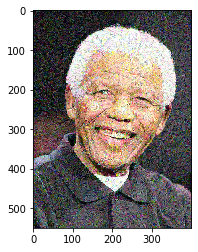

Total loss:  48125922246656.0
Weighted Content loss:  0.05620691552758217
Weighted Style loss:  48125923156738.28
Time [s]:  39.66538739204407


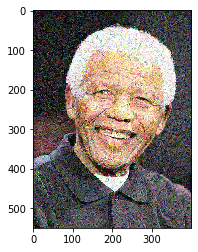

Total loss:  46314347823104.0
Weighted Content loss:  0.05628538504242897
Weighted Style loss:  46314346313476.56
Time [s]:  44.62018132209778


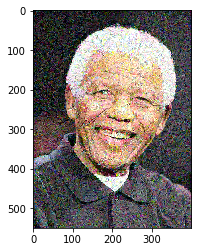

Total loss:  47999405260800.0
Weighted Content loss:  0.056320544332265854
Weighted Style loss:  47999404907226.56
Time [s]:  49.783238887786865


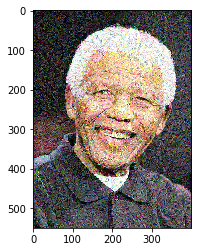

Total Time [s]:  49.928510427474976


In [39]:
# TODO Task 4: Style Transfer for content[3] and style[3] stored in target[3]
[res_3, reslc_3]  = run_model(resnet, layers_resnet, target[3], content_features_resnet[3], style_grams_resnet[3], 'conv4_x', style_weights_resnet, content_weight = 1, style_weight = 1.0e12, steps = 5000, lr = 0.03)

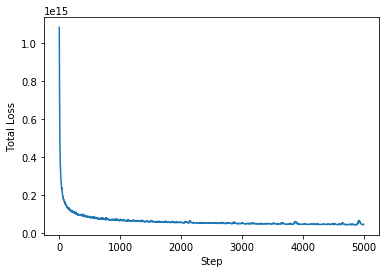

In [40]:
plt.plot(reslc_3)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

In [47]:
# Save results to hard disc
result_to_hd(res_0, "res0_reference.jpg")
result_to_hd(res_1, "res1_reference.jpg")
result_to_hd(res_2, "res2_reference.jpg")
result_to_hd(res_3, "res3_reference.jpg")

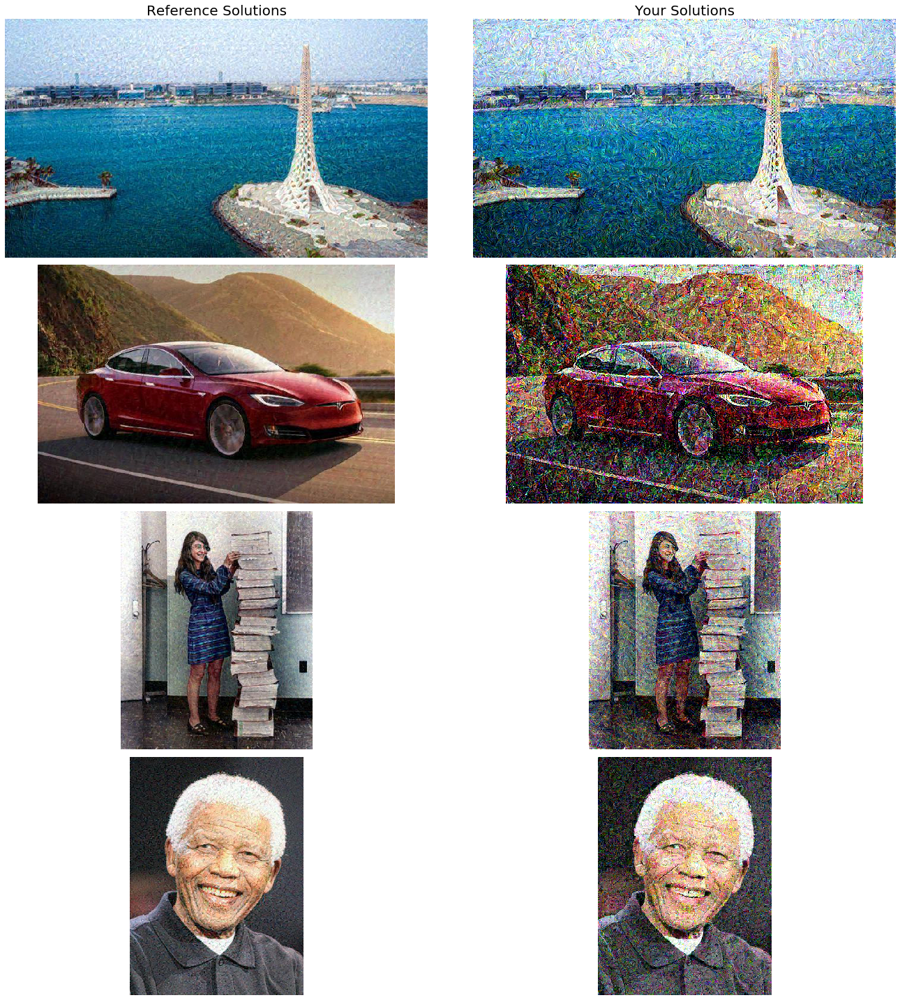

In [45]:
# Comparison to Reference Solution - Do not change anything, just execute to varify correctness of your solution

fig, axs = plt.subplots(num_pairs, 2, figsize=(20, 20))

axs[0, 0].set_title('Reference Solutions', fontsize=20)
axs[0, 1].set_title('Your Solutions', fontsize=20)

# content and correspoinding style image side-by-side
for row in range(0, num_pairs):
        axs[row, 0].imshow(im_convert(ref_res[row]))
        axs[row, 1].imshow(im_convert(target[row]))

        for col in range(0, 2):
            axs[row, col].axis('off')
        
fig.tight_layout()
plt.show()

## Task 6.1: Conclusion
What is the difference between the style transfer results when using VGG or ResNet? Add a short conclusion to your final report.

Conclusion. Visually VGG seems to succeed more in transferring the style. Resnet's modification of an initial image resembles more an added random noise.

## 6.2

Let us try to choose another content layer.

In [50]:
style_weights_resnet_2 = {'conv1' : 1,
                        'conv2_x': 0.8,
                        'conv3_x': 0.5,
                        'conv5_x': 0.1}

Total loss:  58277635293184.0
Weighted Content loss:  0.05086711794137955
Weighted Style loss:  58277633666992.19
Time [s]:  6.325087785720825


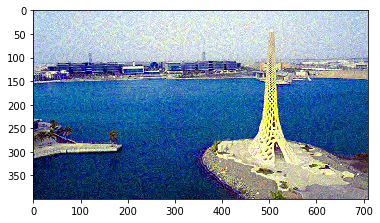

Total loss:  39053751746560.0
Weighted Content loss:  0.0518200546503067
Weighted Style loss:  39053752899169.92
Time [s]:  12.760117530822754


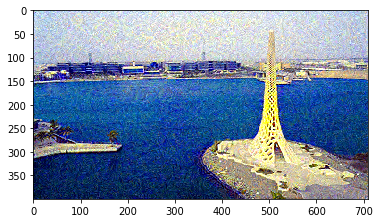

Total loss:  32967426572288.0
Weighted Content loss:  0.0523172989487648
Weighted Style loss:  32967426300048.83
Time [s]:  19.19632840156555


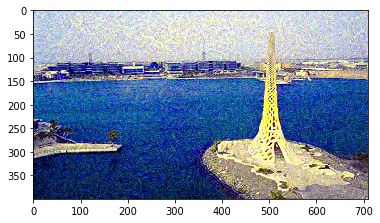

Total loss:  28625095098368.0
Weighted Content loss:  0.05251973122358322
Weighted Style loss:  28625095367431.64
Time [s]:  25.64615797996521


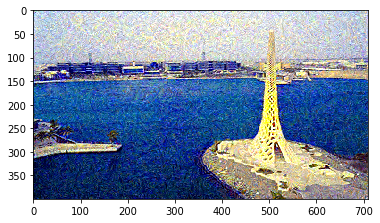

Total loss:  27433608675328.0
Weighted Content loss:  0.05279036611318588
Weighted Style loss:  27433609008789.062
Time [s]:  32.109336614608765


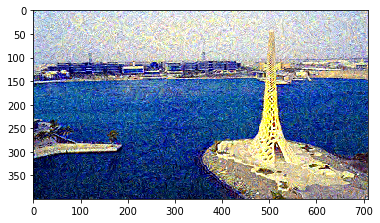

Total loss:  26318678786048.0
Weighted Content loss:  0.05293594300746918
Weighted Style loss:  26318679809570.312
Time [s]:  38.70247411727905


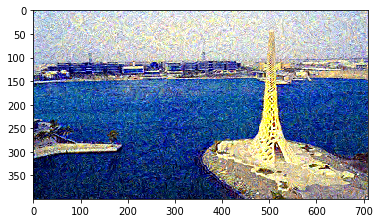

Total loss:  24051152060416.0
Weighted Content loss:  0.05303080752491951
Weighted Style loss:  24051153182983.4
Time [s]:  45.37839984893799


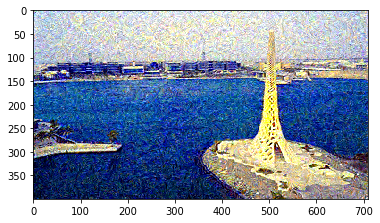

Total loss:  23761134813184.0
Weighted Content loss:  0.05318615213036537
Weighted Style loss:  23761135101318.36
Time [s]:  52.07745099067688


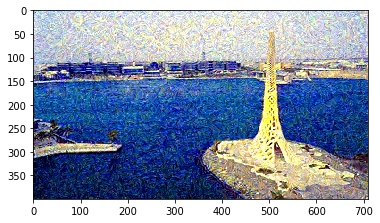

Total loss:  22633554903040.0
Weighted Content loss:  0.0532282255589962
Weighted Style loss:  22633554458618.164
Time [s]:  58.84717917442322


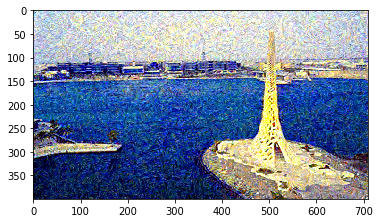

Total loss:  22288986537984.0
Weighted Content loss:  0.05338890105485916
Weighted Style loss:  22288986206054.688
Time [s]:  65.6349892616272


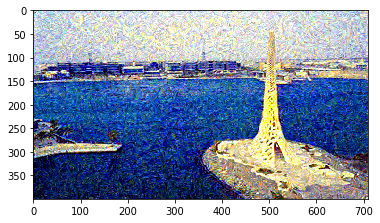

Total Time [s]:  65.81598949432373


In [56]:
# TODO Task 4: Style Transfer for content[0] and style[0] stored in target[0]
[res_0_2, reslc_0_2] = run_model(resnet, layers_resnet, target[0], content_features_resnet[0], style_grams_resnet[0], 'conv4_x', style_weights_resnet_2, content_weight = 1, style_weight = 1.0e12, steps = 5000, lr = 0.03)

# Deep Correlations for Texture synthesis [2]

The paper [2] presents a texture synthesis technique that builds upon convolutional neural networks and extracted statistics of pre-trained deep features. The main contribution is the introduction of *deep correlation matrices* that allow the synthesis of textures that not only resemble local but also global structure of an example image.

## Task 7: VGG Layer Replacement (5 points)

The authors of [2] suggest to replace all MaxPool layers with Averaging layers for better results. This should be done in the cell below.

In [17]:
print(vgg)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [18]:
# Replace MaxPool Layers in VGG19 network with average pooling layers

# TODO Task 7: Identify maxpool layer indices
maxpool_idx = [4, 9, 18, 27, 36]

for i in maxpool_idx:
    # TODO Task 7: Replace maxpool layer with averaging layer (kernel_size = 2, stride = 2)
    vgg[i] = nn.AvgPool2d(kernel_size=2, stride=2)

In [19]:
# Define the layers from which the features are extracted

layers_deepcorr = {'0': 'conv1',
                   '4': 'pool1',
                   '9': 'pool2', 
                  '18': 'pool3', 
                  '27': 'pool4'}  ## content representation

In [20]:
print(vgg)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): AvgPool2d(kernel_size=2, stride=2, padding=0)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): AvgPool2d(kernel_size=2, stride=2, padding=0)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): AvgPool2d(kernel_size=2, stride=2, padding=0)
  (19): Conv2d(256

## Task 8: Implement the computation of the deep correlation matrices $R^{l,n}_{i,j}$ for a given tensor representing layer $l$ as decribed in [2] (10 points)

Note that the computation of $R^{l,n}_{i,j}$ requires a convolution (or more correctly, a cross-correlation) of each feature map with itself. Instead of trying to implement this convolution using nested `for` loops, use the `nn.Conv2d` module for performance reasons. Do not forget to use appropriate zero-padding that allows an output size equal to `output_size` and to set `bias=False`. Further do not forget to compute appropriate weights $w_{i,j}$.

In [21]:
def deep_corr_matrix_stack(tensor, output_size = None):
    """ Calculate the set of Deep Correlation Matrices for a given tensor as described in [2]
    """
    
    # TODO Task 8: implement the computation of the deep correlation matrices
    
    n_feature_maps = tensor.size(1)
    s1, s2 = tensor.size(2), tensor.size(3)
    mask = torch.ones(tensor.size()).type(torch.BoolTensor).to(device)
    if output_size is None:
        output_size = (s1 - 1, s2 - 1)

    size_1_int = torch.from_numpy(np.arange(s1 - output_size[0], s1)).unsqueeze(0).type(torch.FloatTensor)
    size_2_int = torch.from_numpy(np.arange(s2 - output_size[1], s2)).unsqueeze(0).type(torch.FloatTensor)
    weight_matrix = (torch.mm(size_1_int.t(), size_2_int) ** -1).to(device)
        
    conv1 = nn.Conv2d(n_feature_maps, n_feature_maps, kernel_size=(s1, s2), padding=output_size, bias=False)
    conv1.to(device)
    with torch.no_grad():
        conv1.weight.copy_(tensor)
    
    deep_corr = conv1(tensor)[:, :, :output_size[0], :output_size[1]]

    deep_corr = deep_corr * weight_matrix
            
    return deep_corr

## Task 9: Implement the computation of the smoothness loss $E^l_{smooth}$ for a given tensor representing layer $l$ as decribed in [2] (10 points)

Note that Equation 10 defining $E^l_{smooth}$ in the paper [2] is missing an important factor for the sum of exponentials. Please refer to Appendix B for the correct version that directly reflects the equation as it was also implemented by the authors. Further note that the equation implicitly requires each pixel to have exactly 4 neighbors in its 4-connected neighborhood. We therefore have two options to handle boarder pixels:

* If we access an index beyond the image limits, we access the pixel on the opposite image boarder (`circ = True`).
* The pixel values of non-existing neighbors beyond the image limits are assumed to have value 0 (`circ = False`).

You can experiment with both versions, but you only have to implement one to get full points.

In [22]:
def E_smooth(tensor, sigma = 0.001, circ = True):
    
    # get the batch_size, depth, height, and width of the Tensor
    _, d, Q, M = tensor.size()
    
    tensor.squeeze_(0)
    
    # TODO Task 8: Implement the computation of E^l_{smooth}

    tns1, tns2, tns3, tns4 = torch.zeros(d, Q, M).to(device), torch.zeros(d, Q, M).to(device), torch.zeros(d, Q, M).to(device), torch.zeros(d, Q, M).to(device)
        
    tns1[:, 1:, :] = tensor[:, :-1, :]
    tns2[:, :-1, :] = tensor[:, 1:, :]
    tns3[:, :, 1:] = tensor[:, :, :-1]    
    tns4[:, :, :-1] = tensor[:, :, 1:]

    if circ:
        tns1[:, 0, :] = tensor[:, -1, :]
        tns2[:, -1, :] = tensor[:, 0, :]
        tns3[:, :, 0] = tensor[:, :, -1]
        tns4[:, :, -1] = tensor[:, :, 0]
                
    final = torch.log((torch.exp( - sigma * (tns1 - tensor) ** 2)  + torch.exp( - sigma * (tns2 - tensor) ** 2) + 
    torch.exp(- sigma * (tns3 - tensor) ** 2) + torch.exp( - sigma * (tns4 - tensor) ** 2) * 0.25))
    e_smooth = final.sum() / (2 * sigma)
                      
    assert e_smooth.dim() < 2

    return e_smooth

In [23]:
def white_gauss_noise(size, mu = 0, sigma = 1.0e-3):
    m = torch.distributions.normal.Normal(mu, sigma)
    return m.sample(size)

In [24]:
''' Define and load texture files '''

texture_files = ['Texture13', 'Texture25', 'Texture62', 'Texture115']
ref_tex_files = ['tex0_ref', 'tex1_ref', 'tex2_ref', 'tex3_ref']

# load in texture images
texture_size = 225
texture = [load_image('img/texture/' + t + '.png', texture_size).to(device) for t in texture_files]

ref_tex = [load_image('img/ref/' + t + '.jpg', texture_size).to(device) for t in ref_tex_files]

target = [white_gauss_noise((t.shape[0], t.shape[1], t.shape[2], t.shape[3]), mu = 0, sigma = 0.01).to(device).requires_grad_(True) for t in texture]

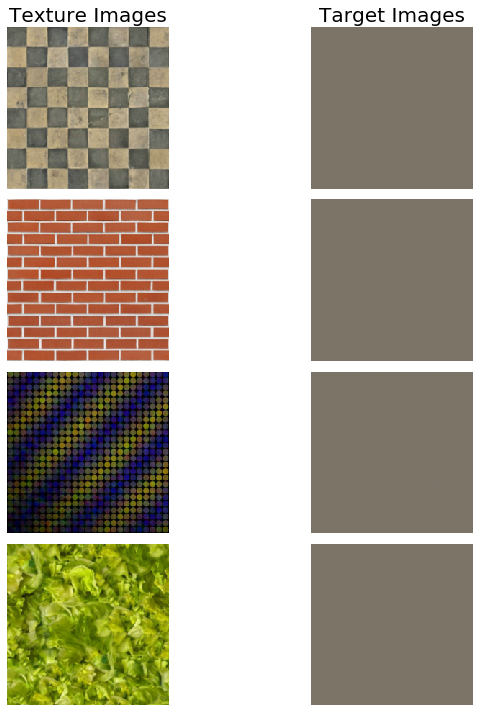

In [25]:
# display the images
num_textures = len(texture)
fig, axs = plt.subplots(num_pairs, 2, figsize=(10, 10))

axs[0, 0].set_title('Texture Images', fontsize=20)
axs[0, 1].set_title('Target Images', fontsize=20)

# content and correspoinding style image side-by-side
for row in range(0, num_pairs):
        axs[row, 0].imshow(im_convert(texture[row]))
        axs[row, 1].imshow(im_convert(target[row]))

        for col in range(0, 2):
            axs[row, col].axis('off')
        
fig.tight_layout()
plt.show()

In [26]:
# weights and parameters (cf. Table 1 in the paper [2])

# alpha, beta, gamma and delta corresponding to the loss weights for E_Grm, E_DCor, E_Div and E_Smooth
alpha = 0.5
beta = 0.5
gamma = -1.0e-4
delta = -0.75e-3

gram_layer_weights = {'pool1': 0.25,
                      'pool2': 0.25,
                      'pool3': 0.25,
                      'pool4': 0.25}

dcor_layer_weights = {'pool2': 1}
div_layer_weights = {'pool2': 1}
smooth_layer_weights = {'conv1': 1}

sigma = 1.0e-3

In [27]:
# get texture features only once before training
texture_features = [get_features(t, vgg, layers_deepcorr) for t in texture]
#style_features = [get_features(s, vgg) for s in style]

# calculate gram matrices G
texture_grams = [{layer: gram_matrix(t[layer]) for layer in t if layer in gram_layer_weights} for t in texture_features]

# calculate deep correlation matrices R
texture_dcors = [{layer: deep_corr_matrix_stack(t[layer]) for layer in t if layer in dcor_layer_weights} for t in texture_features]

# pick features for E_Div
texture_divs = [{layer: t[layer] for layer in t if layer in div_layer_weights} for t in texture_features]

# pick features for E_Smooth
texture_smooths = [{layer: t[layer] for layer in t if layer in smooth_layer_weights} for t in texture_features]

## Task 10: Texture Synthesis Function (10 points - 4 examples, 2.5 points each)

Complete the texture synthesis function below. Note that we do not use the Adam optmizer this time but LBFGS.

In [28]:
def texture_synthesis_lbfgs(tex_idx, lr = 1):

    # for displaying the target image, intermittently
    save_every = 10
    print_every = 10
    
    def closure():

        # get the features from your target image
        target_features = get_features(target[tex_idx], vgg, layers_deepcorr)

        # E_Grm
        E_Grm = 0
        if alpha != 0:
            for layer in gram_layer_weights:
                target_feature = target_features[layer]
                _, d, Q, M = target_feature.size()
                
                # TODO Task 10: Compute E_l_Grm as defined in [2]
                target_gram = gram_matrix(target_feature)
                texture_gram = texture_grams[tex_idx][layer]
                E_l_Grm = torch.sum((target_gram - texture_gram) ** 2) / (2 * Q ** 2 * M ** 2) * gram_layer_weights[layer]
                
                E_Grm = E_Grm + E_l_Grm
                
        # E_DCor
        E_DCor = 0
        if beta != 0:
            for layer in dcor_layer_weights:
                target_feature = target_features[layer]
                _, d, Q, M = target_feature.size()

                # TODO Task 10: Compute E_l_Dcor as defined in [2]
                target_dcor = deep_corr_matrix_stack(target_feature)
                texture_dcor = texture_dcors[tex_idx][layer]
                E_l_Dcor = 0.25 * ((target_dcor - texture_dcor) ** 2).sum() * dcor_layer_weights[layer]

                E_DCor = E_DCor + E_l_Dcor
    
        # E_Div
        E_Div = 0
        if gamma != 0:
            for layer in div_layer_weights:
                target_feature = target_features[layer]
                
                
                # TODO Task 10: Compute E_l_Div as defined in [2]
                texture_div = texture_divs[tex_idx][layer]
                _, _, Q, M = texture_div.size()
                target_div = target_feature[:, :, :Q, :M]
                E_l_Div = - ((target_div - texture_div) ** 2).sum() * div_layer_weights[layer]

                E_Div = E_Div + E_l_Div

        # E_Smooth
        E_Smooth = 0
        if delta != 0:
            for layer in smooth_layer_weights:
                
                target_feature = target_features[layer]
                
                # TODO Task 10: Compute E_l_Smooth as shown in Appendix B
                E_l_Smooth = E_smooth(target_feature) * smooth_layer_weights[layer]

                E_Smooth = E_Smooth + E_l_Smooth

        # calculate the *total* loss
        
        # TODO Task 10: Compute the total loss as defined in [2] and shown in Appendix B
        total_loss = alpha * E_Grm + beta * E_DCor + gamma * E_Div + delta * E_Smooth

        # update your target image
        optimizer.zero_grad()
        total_loss.backward()
        # optimizer.step()
        return total_loss

    # iteration hyperparameters
    start = time.time()
    
    # Similar to the reference implementation by the authors of [2], we use LBFGS this time to optimize our texture
    
    # torch.optim.LBFGS(params, lr=1, max_iter=20, max_eval=None, tolerance_grad=1e-05, tolerance_change=1e-09, history_size=100, line_search_fn=None)
    optimizer = optim.LBFGS([target[tex_idx]], lr=lr, max_iter=300)
    optimizer.step(closure)

    end = time.time()
    print('Total Time [s]: ', (end - start))
    
    return target[tex_idx]

In [29]:
# Reset Targets to Noise if they have changed

target = [white_gauss_noise((t.shape[0], t.shape[1], t.shape[2], t.shape[3]), mu = 0, sigma = 0.001).to(device).requires_grad_(True) for t in texture]

## Task 11: Texture Synthesis (5 points, 1.25 points each)
Test you implementation for texture synthesis on four examples. Report the total time for synthesis together with the results.

In [30]:
# Texture Synthesis of a texture that is similar to target[0]
torch.autograd.set_detect_anomaly(True)
tex_0 = texture_synthesis_lbfgs(0)

/tmp/pip-req-build-p5q91txh/torch/csrc/autograd/python_anomaly_mode.cpp:57: UserWarning: Traceback of forward call that caused the error:
  File "/home/gasanoe/anaconda3/envs/py3/lib/python3.6/runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "/home/gasanoe/anaconda3/envs/py3/lib/python3.6/runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "/home/gasanoe/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "/home/gasanoe/anaconda3/envs/py3/lib/python3.6/site-packages/traitlets/config/application.py", line 658, in launch_instance
    app.start()
  File "/home/gasanoe/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel/kernelapp.py", line 563, in start
    self.io_loop.start()
  File "/home/gasanoe/anaconda3/envs/py3/lib/python3.6/site-packages/tornado/platform/asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "/home/gasanoe/anaconda3/envs/

RuntimeError: one of the variables needed for gradient computation has been modified by an inplace operation: [torch.cuda.FloatTensor [1, 64, 225, 225]], which is output 0 of ReluBackward1, is at version 2; expected version 1 instead. Hint: the backtrace further above shows the operation that failed to compute its gradient. The variable in question was changed in there or anywhere later. Good luck!

In [ ]:
# Texture Synthesis of a texture that is similar to target[1]
tex_1 = texture_synthesis_lbfgs(1)

In [ ]:
# Texture Synthesis of a texture that is similar to target[2]
tex_2 = texture_synthesis_lbfgs(2)

In [ ]:
# Texture Synthesis of a texture that is similar to target[3]
tex_3 = texture_synthesis_lbfgs(3)

In [ ]:
# Save results to hard disc
result_to_hd(tex_0, "tex0_ref.jpg")
result_to_hd(tex_1, "tex1_ref.jpg")
result_to_hd(tex_2, "tex2_ref.jpg")
result_to_hd(tex_3, "tex3_ref.jpg")

In [ ]:
# Comparison to Reference Solution - Do not change anything, just execute to varify correctness of your solution

fig, axs = plt.subplots(num_pairs, 3, figsize=(20, 20))

axs[0, 0].set_title('Input', fontsize=20)
axs[0, 1].set_title('Reference Solutions', fontsize=20)
axs[0, 2].set_title('Your Solutions', fontsize=20)

# content and correspoinding style image side-by-side
for row in range(0, num_pairs):
        axs[row, 0].imshow(im_convert(texture[row]))
        axs[row, 1].imshow(im_convert(ref_tex[row]))
        axs[row, 2].imshow(im_convert(target[row]))

        for col in range(0, 3):
            axs[row, col].axis('off')
        
fig.tight_layout()
plt.show()

## Useful Commands
* For the computation of the gram matrix a stretching of each 2d activation map into a vector is required, this can be easily done by applying the [torch.Tensor.view](https://pytorch.org/docs/stable/tensors.html#torch.Tensor.view) command.
* The transpose of a torch matrix can be obtained using [torch.Tensor.transpose](https://pytorch.org/docs/stable/tensors.html?#torch.Tensor.transpose)
* Two torch matrices (tensors with 2 dimensions, a height and a width) can be multiplied using [torch.mm](https://pytorch.org/docs/stable/torch.html#torch.mm)
* The scalar mean of an arbitrary shaped tensor can be computed using [torch.mean](https://pytorch.org/docs/stable/torch.html#torch.mean)
* The dimensionality of a tensor (`batch_size`, `num_channels`, `height`, `width`) can be queried using [torch.Tensor.size](https://pytorch.org/docs/stable/tensors.html?highlight=size#torch.Tensor.size)
* A subsection of a Pytorch tensor can be obtained by using the [torch.narrow](https://pytorch.org/docs/stable/torch.html#torch.narrow) command or by referring to the desired subsection with a command similar to `tensor[:, :, 1:, :]`. In this example, one would obtain a slice with the first index of the third dimension removed.

## References


[1]	Gatys, Ecker, and Bethge, “Image Style Transfer Using Convolutional Neural Networks”,
CVPR 2016, [Paper](https://ieeexplore.ieee.org/document/7780634)

[2]	Sendik, and Cohen-Or, “Deep Correlations for Texture synthesis”, Siggraph 2017, [Paper](https://dl.acm.org/citation.cfm?id=3015461)

[3]	torchvision.models, https://pytorch.org/docs/stable/torchvision/models.html

[4]	Gramian Matrix, https://en.wikipedia.org/wiki/Gramian_matrix

## Appendix A - Details of [1]

Let $N_l$ be the number of feature maps at layer $l$ and let $M_l$ be the number of scalar values in each feature map, hence the height times the width of each feature map at layer $l$. By stretching the $2d$ responses in each feature map into a $1d$ vector, the responses at layer $l$ can therefore be stored in a matrix $F^l \in \mathbb{R}^{N_l \times M_l}$ where $F^l_{ij}$ is the activation value of the $i^{th}$ filter at position $j$ in layer $l$. Let further be $P^l$ and $F^l$ the feature representations of the content image $\vec{p}$ and the target image $\vec{x}$ in layer $l$ respectively.

#### Content Loss

Since we want to keep the content of $\vec{p}$ in our target image $\vec{x}$, it is a reasonable choice to minimize the squared difference between their corresponding activations $P^l$ and $F^l$. Recall that in higher layers of a neural network, detailed pixel information about the input image is usually lost, while information about the high-level content is preserved. In order to preserve the content it is therefore a good idea to choose a layer number corresponding to one of the higher layers $l$ (e.g. corresponding to `conv4_2` in VGG19) to define the content loss $\mathcal{L}_{\textrm{content}}$:


$$ \mathcal{L}_{\textrm{content}} \left( \vec{p}, \vec{x},l \right) = \frac{1}{N_l M_l} \sum_{i,j} \left( F^l_{ij} - P^l_{ij} \right)^2 = \textrm{mean}\left( \left( F^l - P^l \right) \odot \left( F^l - P^l \right) \right)$$

Note that this definition is slightly different from the original paper [1]. It is however highly recommended to take the mean of the sum of squares to be independet to the extent of the respective layer $l$.

##### Gram matrix

In order to preserve the style of the style image a we can not directly compare the feature maps of $\vec{a}$ and $\vec{x}$, but we can (as described in [1]) compare feature correlations which are given by the Gram matrix [4] $G^l \in \mathbb{R}^{N_l \times N_l}$ where $G^l_{ij}$ is the inner product between the vectorised feature maps $i$ and $j$ in layer $l$:

$$G^l_{ij} = \sum_{k} F^l_{ik} F^l_{jk}$$

#### Style Loss

We obtain a multi-scale representation of the style image by taking several layers l into account. Let $A^l$ and $G^l$ be the style representations (given by the corresponding Gram matrix) of the style image $\vec{a}$ and the target image $\vec{x}$ respectively, the contribution of layer $l$ to the style loss can then be defined as

$$ E_l = \frac{1}{N^2_l M^2_l} \sum_{i,j} \left( G^l_{ij} - A^l_{ij} \right)^2 = \frac{1}{M_l^2} \textrm{mean}\left( \left( G^l - A^l \right) \odot \left( G^l - A^l \right) \right) $$

Note that this definition of the style loss is also a bit different from from the paper.

By choosing a suitable weight $w_l$ for each layer $l$ we obtain the style loss $\mathcal{L}_{\textrm{style}}$ as

$$ \mathcal{L}_{\textrm{style}} \left( \vec{a}, \vec{x} \right) = \sum_{l=0}^{L} w_l E_l $$

The total loss is simply a weighted sum of the content loss and the style loss:

$$ \mathcal{L}_{\textrm{total}} \left( \vec{p}, \vec{a}, \vec{x} \right) = \alpha \mathcal{L}_{\textrm{content}} \left( \vec{p}, \vec{x} \right) + \beta \mathcal{L}_{\textrm{style}} \left( \vec{a}, \vec{x} \right) $$

Although this has not to be done in code explicitly, it is highly recommended to verify that the necessary gradients $\frac{\partial \mathcal{L}_{\textrm{content}}}{\partial F^l_{ij}}$ and $\frac{\partial E_l}{\partial F^l_{ij}}$, both with respect to the activations in the layer $l$, can be analytically derived as

$$\frac{\partial \mathcal{L}_{\textrm{content}}}{\partial F^l_{ij}} = \begin{cases} \begin{array}{lr} \frac{2}{N_l M_l} \left( F^l - P^l \right)_{ij} & \textrm{if} \; F^l_{ij}>0 \\ 0 & \textrm{if} \; F^l_{ij} \leq 0 \end{array} \end{cases}$$

$$\frac{\partial E_l}{\partial F^l_{ij}} = \begin{cases} \begin{array}{lr} \frac{2}{N_l^2 M^2_l} \left( \left( F^l \right)^T \left( G^l - A^l \right) \right)_{ji} & \textrm{if} \; F^l_{ij}>0 \\ 0 & \textrm{if} \; F^l_{ij} \leq 0 \end{array} \end{cases}$$

## Appendix B - Details of [2]

The approach presented in [2] is very similar to the method proposed in [1], the main contribution is the computation of the *deep correlation matrices* to obtain results that are similar to the input image both on a local and a global scale. For completeness (and in the case of $E^l_{smooth}$ for error correction), the essential equations of the proposed method are presented in the following.

$$E^l_{smooth} = \frac{1}{2 \sigma} \sum_{i,j,n} \textrm{log} \left( \frac{1}{4} \sum_{\delta i, \delta j} \textrm{exp} \left( -\sigma \cdot \left( f^{l,n}_{i,j} - f^{l,n}_{i + \delta i, j + \delta j} \right)^2 \right) \right)$$

$$E_{smooth} = \sum_{l} w^S_l E^l_{Smoooth}$$